In [1]:
                                    # This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/jeju-dataset/sample_submission.csv
/kaggle/input/jeju-dataset/train.csv
/kaggle/input/jeju-dataset/test.csv
/kaggle/input/jeju-dataset/international_trade.csv


In [2]:
import pandas as pd
import numpy as np
from tqdm.auto import tqdm

DATA_PATH = '/kaggle/input/jeju-dataset/'

SEED = 42

train = pd.read_csv(f'{DATA_PATH}train.csv')
test = pd.read_csv(f'{DATA_PATH}test.csv')
submission = pd.read_csv(f'{DATA_PATH}sample_submission.csv')
trade = pd.read_csv(f'{DATA_PATH}international_trade.csv')


In [3]:
train

,ID,timestamp,item,corporation,location,supply(kg),price(원/kg)
0,TG_A_J_20190101,2019-01-01,TG,A,J,0.0,0.0
1,TG_A_J_20190102,2019-01-02,TG,A,J,0.0,0.0
2,TG_A_J_20190103,2019-01-03,TG,A,J,60601.0,1728.0
3,TG_A_J_20190104,2019-01-04,TG,A,J,25000.0,1408.0
4,TG_A_J_20190105,2019-01-05,TG,A,J,32352.0,1250.0
...,...,...,...,...,...,...,...
59392,RD_F_J_20230227,2023-02-27,RD,F,J,452440.0,468.0
59393,RD_F_J_20230228,2023-02-28,RD,F,J,421980.0,531.0
59394,RD_F_J_20230301,2023-03-01,RD,F,J,382980.0,574.0
59395,RD_F_J_20230302,2023-03-02,RD,F,J,477220.0,523.0


In [4]:
train = train.rename(columns = {'supply(kg)':'supply','price(원/kg)':'price'})

In [5]:

train['name'] = train['ID'].apply(lambda x : x[:6])
test['name'] = test['ID'].apply(lambda x : x[:6])

In [6]:
train['timestamp'] = pd.to_datetime(train['timestamp'])
train['year'] = train['timestamp'].dt.year
train['month'] = train['timestamp'].dt.month
train['day'] = train['timestamp'].dt.day
train['day_of_week'] = train['timestamp'].dt.dayofweek


In [7]:
train

,ID,timestamp,item,corporation,location,supply,price,name,year,month,day,day_of_week
0,TG_A_J_20190101,2019-01-01,TG,A,J,0.0,0.0,TG_A_J,2019,1,1,1
1,TG_A_J_20190102,2019-01-02,TG,A,J,0.0,0.0,TG_A_J,2019,1,2,2
2,TG_A_J_20190103,2019-01-03,TG,A,J,60601.0,1728.0,TG_A_J,2019,1,3,3
3,TG_A_J_20190104,2019-01-04,TG,A,J,25000.0,1408.0,TG_A_J,2019,1,4,4
4,TG_A_J_20190105,2019-01-05,TG,A,J,32352.0,1250.0,TG_A_J,2019,1,5,5
...,...,...,...,...,...,...,...,...,...,...,...,...
59392,RD_F_J_20230227,2023-02-27,RD,F,J,452440.0,468.0,RD_F_J,2023,2,27,0
59393,RD_F_J_20230228,2023-02-28,RD,F,J,421980.0,531.0,RD_F_J,2023,2,28,1
59394,RD_F_J_20230301,2023-03-01,RD,F,J,382980.0,574.0,RD_F_J,2023,3,1,2
59395,RD_F_J_20230302,2023-03-02,RD,F,J,477220.0,523.0,RD_F_J,2023,3,2,3


In [8]:
train.price

0           0.0
1           0.0
2        1728.0
3        1408.0
4        1250.0
          ...  
59392     468.0
59393     531.0
59394     574.0
59395     523.0
59396     529.0
Name: price, Length: 59397, dtype: float64

In [9]:
train.name.unique()

array(['TG_A_J', 'TG_A_S', 'TG_B_J', 'TG_B_S', 'TG_C_J', 'TG_C_S',
       'TG_D_J', 'TG_D_S', 'TG_E_J', 'TG_E_S', 'CR_A_J', 'CR_B_J',
       'CR_C_J', 'CR_D_J', 'CR_D_S', 'CR_E_J', 'CR_E_S', 'CB_A_J',
       'CB_A_S', 'CB_D_J', 'CB_E_J', 'RD_A_J', 'RD_A_S', 'RD_C_S',
       'RD_D_J', 'RD_D_S', 'RD_E_J', 'RD_E_S', 'BC_A_J', 'BC_A_S',
       'BC_B_J', 'BC_B_S', 'BC_C_J', 'BC_C_S', 'BC_D_J', 'BC_E_J',
       'BC_E_S', 'CB_F_J', 'RD_F_J'], dtype=object)

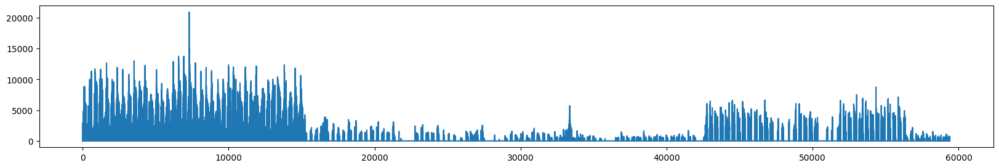

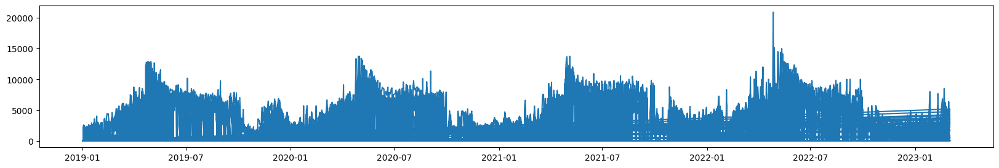

In [10]:
import matplotlib.pyplot as plt

plt.figure(figsize=(20,3))
plt.plot(train.timestamp.index, train.price,linestyle='-')

plt.figure(figsize=(20,3))
plt.plot(train.timestamp, train.price,linestyle='-')

In [11]:
train

,ID,timestamp,item,corporation,location,supply,price,name,year,month,day,day_of_week
0,TG_A_J_20190101,2019-01-01,TG,A,J,0.0,0.0,TG_A_J,2019,1,1,1
1,TG_A_J_20190102,2019-01-02,TG,A,J,0.0,0.0,TG_A_J,2019,1,2,2
2,TG_A_J_20190103,2019-01-03,TG,A,J,60601.0,1728.0,TG_A_J,2019,1,3,3
3,TG_A_J_20190104,2019-01-04,TG,A,J,25000.0,1408.0,TG_A_J,2019,1,4,4
4,TG_A_J_20190105,2019-01-05,TG,A,J,32352.0,1250.0,TG_A_J,2019,1,5,5
...,...,...,...,...,...,...,...,...,...,...,...,...
59392,RD_F_J_20230227,2023-02-27,RD,F,J,452440.0,468.0,RD_F_J,2023,2,27,0
59393,RD_F_J_20230228,2023-02-28,RD,F,J,421980.0,531.0,RD_F_J,2023,2,28,1
59394,RD_F_J_20230301,2023-03-01,RD,F,J,382980.0,574.0,RD_F_J,2023,3,1,2
59395,RD_F_J_20230302,2023-03-02,RD,F,J,477220.0,523.0,RD_F_J,2023,3,2,3


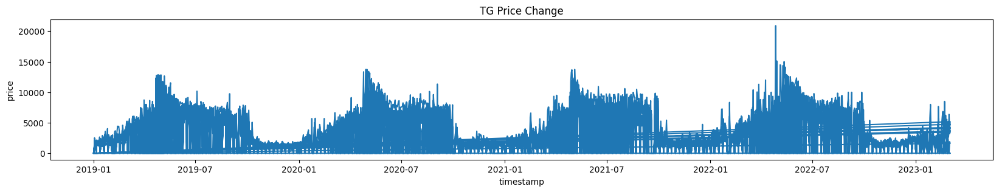

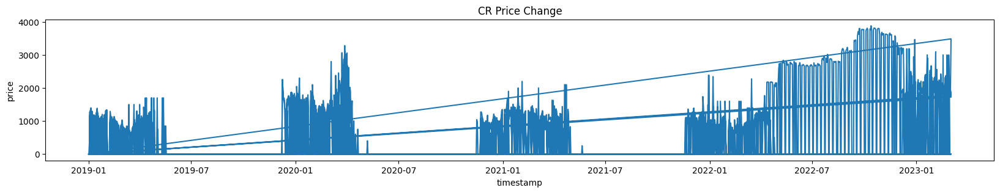

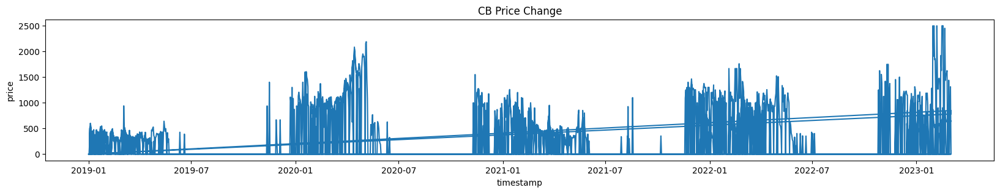

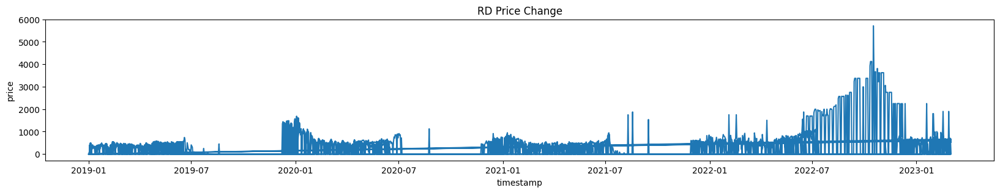

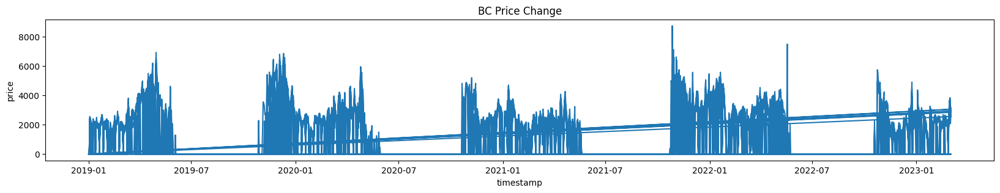

In [12]:
# 아이템별 

# 상품별 
for item in train.item.unique():
    plt.figure(figsize=(20,3))
    plt.title(f'{item} Price Change')
    plt.xlabel('timestamp')
    plt.ylabel('price')
    plt.plot(train.timestamp[train.item==item], train.price[train.item==item])

/tmp/ipykernel_32/4042868942.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(20,3))


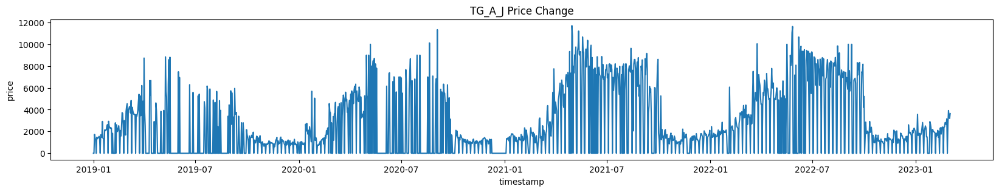

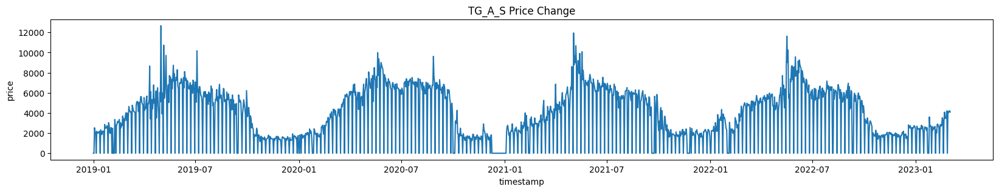

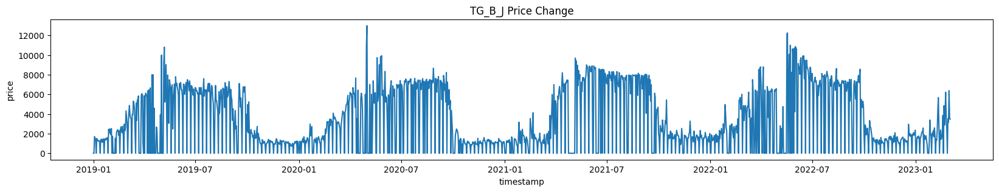

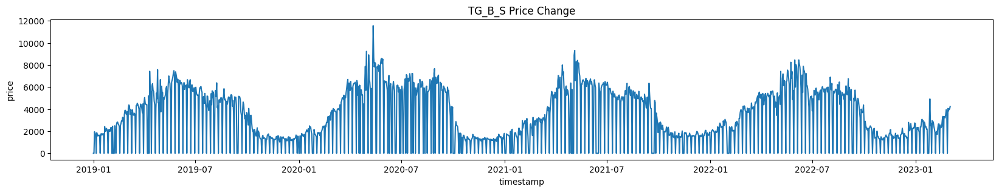

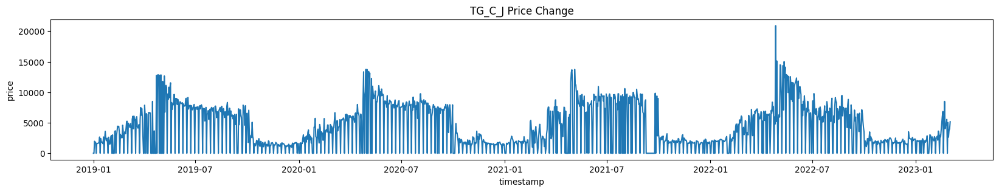

...

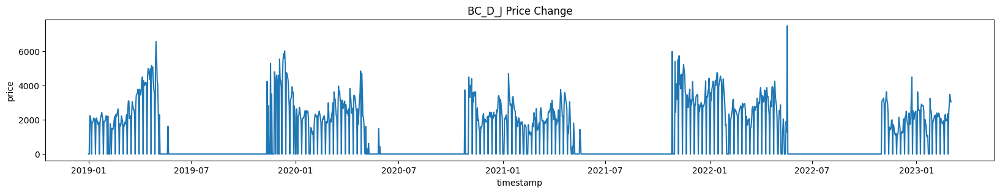

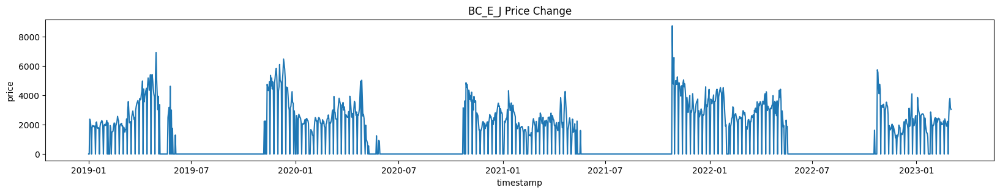

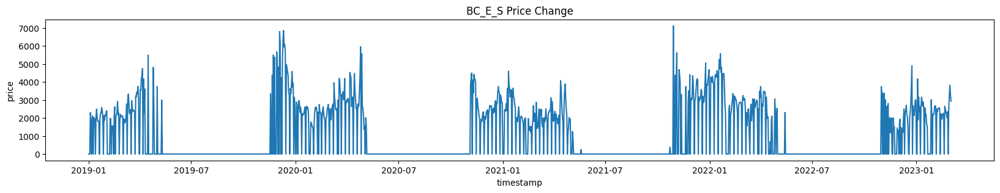

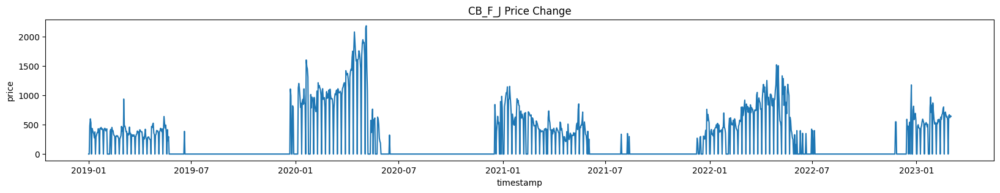

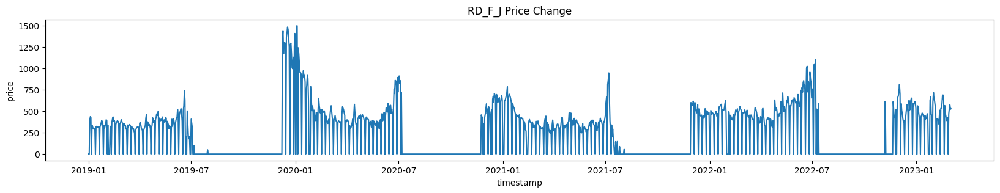

In [13]:
# 상품별 
for name in train.name.unique():
    plt.figure(figsize=(20,3))
    plt.title(f'{name} Price Change')
    plt.xlabel('timestamp')
    plt.ylabel('price')
    plt.plot(train.timestamp[train.name==name], train.price[train.name==name],linestyle='-')

In [14]:
df = train[['timestamp','price','supply']]

print('price min-max :', train['price'].min(), train['price'].max())
print('supply min-max :', train['supply'].min(), train['supply'].max())

from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
df_scaled = pd.DataFrame(scaler.fit_transform(df.iloc[:,1:]))
df_scaled

price min-max : 0.0 20909.0
supply min-max : 0.0 1222800.0


,0,1
0,0.000000,0.000000
1,0.000000,0.000000
2,0.082644,0.049559
3,0.067339,0.020445
4,0.059783,0.026457
...,...,...
59392,0.022383,0.370003
59393,0.025396,0.345093
59394,0.027452,0.313199
59395,0.025013,0.390268


In [15]:
df_scaled.columns = ['scaled_price','scaled_supply']
train = pd.concat([train,df_scaled],axis=1)
train

,ID,timestamp,item,corporation,location,supply,price,name,year,month,day,day_of_week,scaled_price,scaled_supply
0,TG_A_J_20190101,2019-01-01,TG,A,J,0.0,0.0,TG_A_J,2019,1,1,1,0.000000,0.000000
1,TG_A_J_20190102,2019-01-02,TG,A,J,0.0,0.0,TG_A_J,2019,1,2,2,0.000000,0.000000
2,TG_A_J_20190103,2019-01-03,TG,A,J,60601.0,1728.0,TG_A_J,2019,1,3,3,0.082644,0.049559
3,TG_A_J_20190104,2019-01-04,TG,A,J,25000.0,1408.0,TG_A_J,2019,1,4,4,0.067339,0.020445
4,TG_A_J_20190105,2019-01-05,TG,A,J,32352.0,1250.0,TG_A_J,2019,1,5,5,0.059783,0.026457
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59392,RD_F_J_20230227,2023-02-27,RD,F,J,452440.0,468.0,RD_F_J,2023,2,27,0,0.022383,0.370003
59393,RD_F_J_20230228,2023-02-28,RD,F,J,421980.0,531.0,RD_F_J,2023,2,28,1,0.025396,0.345093
59394,RD_F_J_20230301,2023-03-01,RD,F,J,382980.0,574.0,RD_F_J,2023,3,1,2,0.027452,0.313199
59395,RD_F_J_20230302,2023-03-02,RD,F,J,477220.0,523.0,RD_F_J,2023,3,2,3,0.025013,0.390268


/tmp/ipykernel_32/3444992336.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(20, 3))  # plt.figure를 함수로 호출하여 figure를 생성


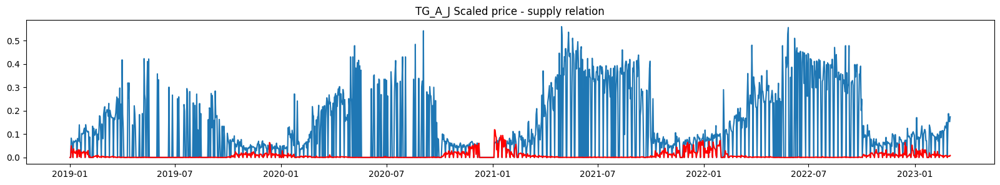

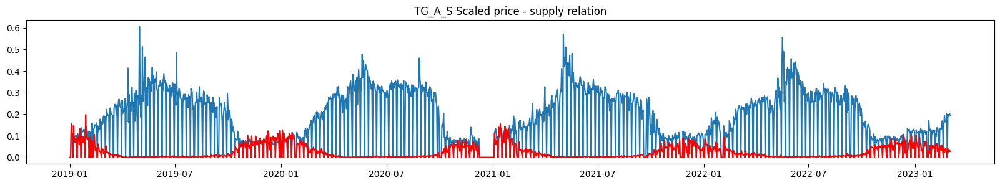

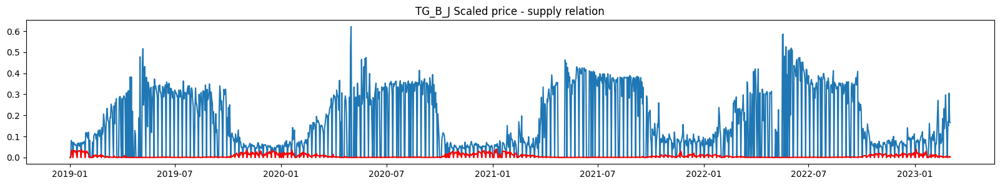

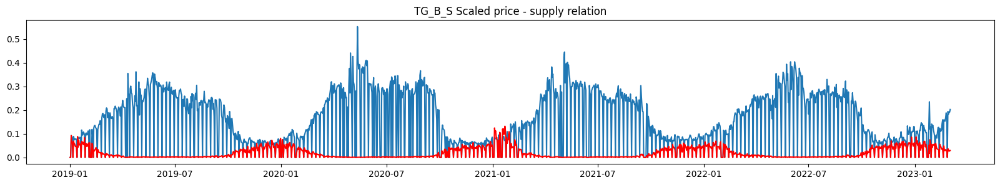

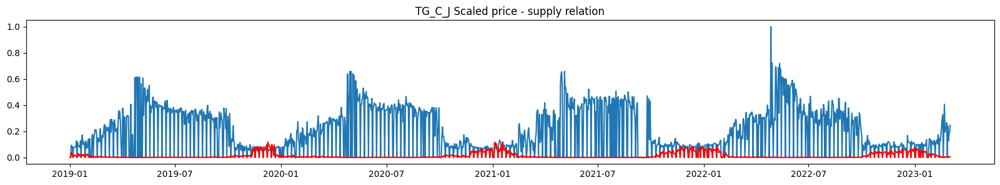

...

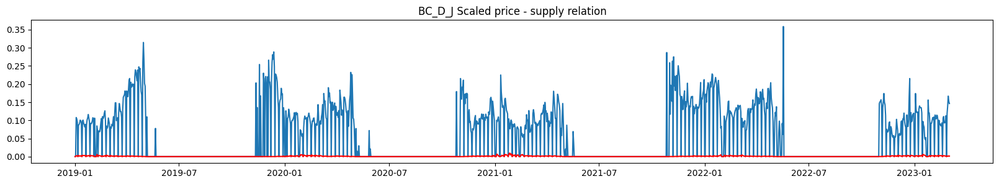

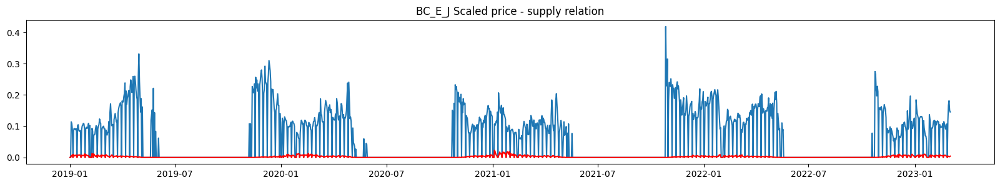

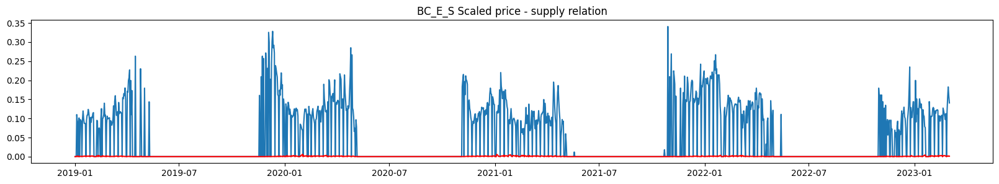

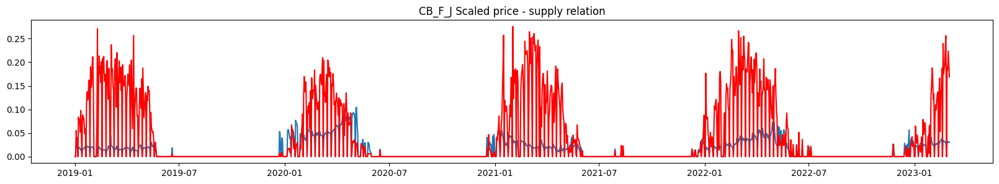

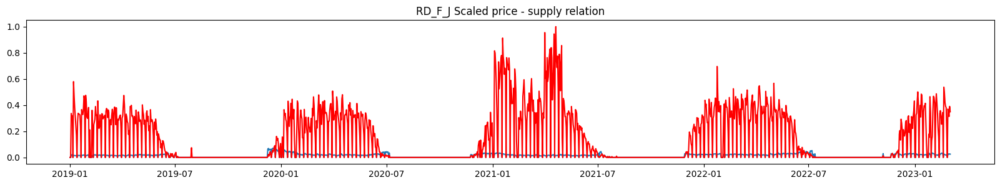

In [16]:
# 
import matplotlib.pyplot as plt

for name in train.name.unique():
    plt.figure(figsize=(20, 3))  # plt.figure를 함수로 호출하여 figure를 생성
    plt.title(f'{name} Scaled price - supply relation')
    plt.plot(train.timestamp[train.name==name], train.scaled_price[train.name==name], linestyle='-')
    plt.plot(train.timestamp[train.name==name], train.scaled_supply[train.name==name], linestyle='-', color='r')


/tmp/ipykernel_32/1698630712.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(20,3))


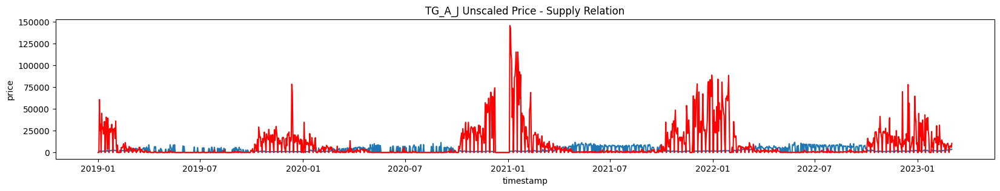

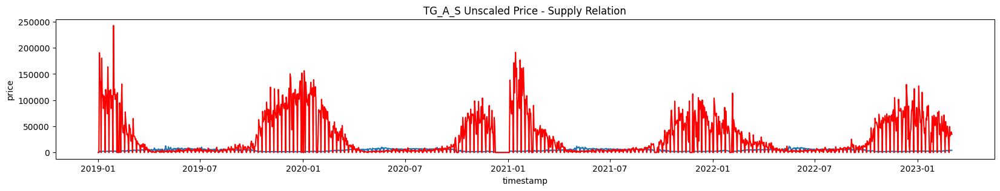

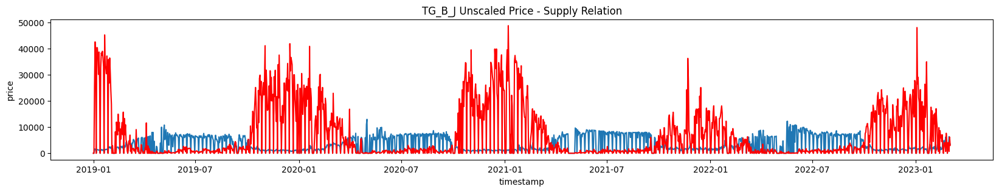

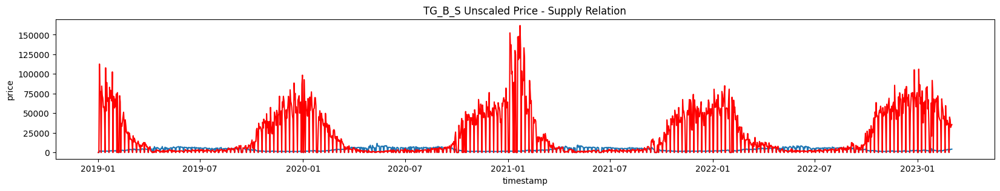

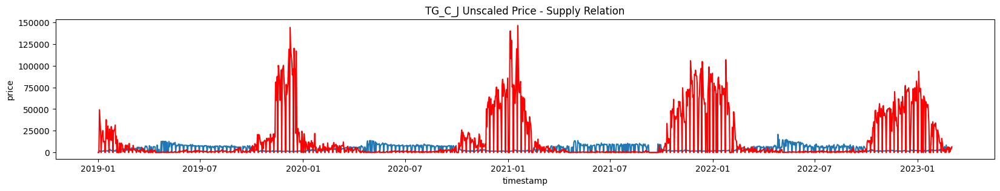

...

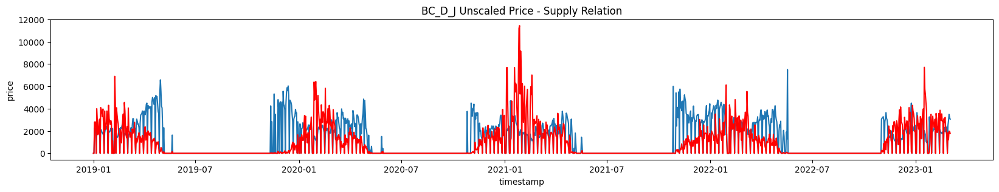

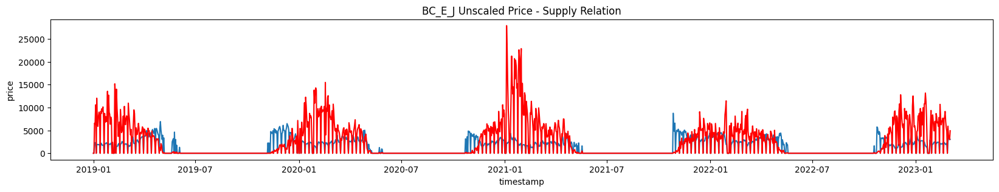

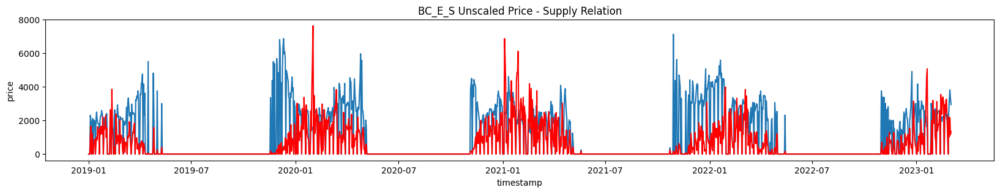

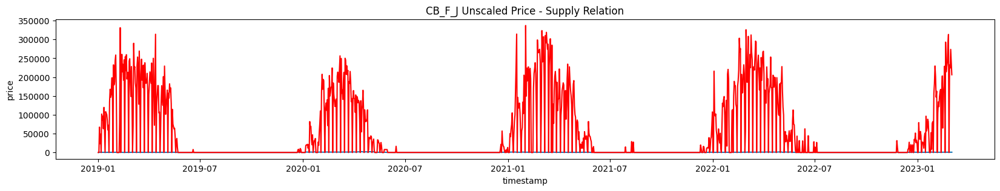

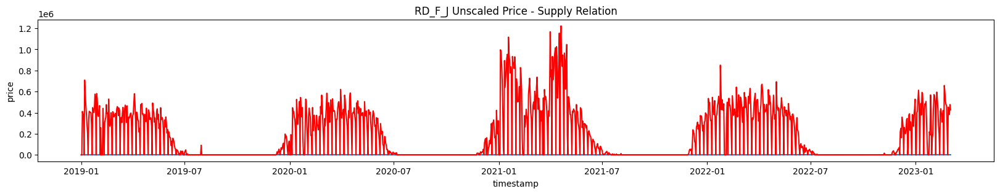

In [17]:
# 상품별 
for name in train.name.unique():
    plt.figure(figsize=(20,3))
    plt.title(f'{name} Unscaled Price - Supply Relation')
    plt.xlabel('timestamp')
    plt.ylabel('price')
    plt.plot(train.timestamp[train.name==name], train.price[train.name==name],linestyle='-')
    plt.plot(train.timestamp[train.name==name], train.supply[train.name==name],linestyle='-',color='r')

In [18]:
trade = pd.read_csv(f'{DATA_PATH}international_trade.csv')
trade.head(5)

,기간,품목명,수출 중량,수출 금액,수입 중량,수입 금액,무역수지
0,2019-01,토마토(신선한 것이나 냉장한 것으로 한정한다),356571,990,0,0,990
1,2019-01,양파,821330,222,4003206,1118,-896
2,2019-01,쪽파,60,1,93405,128,-127
3,2019-01,꽃양배추와 브로콜리(broccoli),160,1,638913,563,-562
4,2019-01,방울다다기 양배추,0,0,7580,38,-38


In [19]:
numbers = [1166.51, 1179.90, 1145.07, 1293.68, 1308.34]
sum(numbers) / len(numbers)
# 연도별 환율 기준 -> 약 1200원으로 계산 
# 2019년 : 1,166.51원
# 2020년 : 1,179.90원
# 2021년 : 1,145.07원 
# 2022년 : 1,293.68원 
# 2023년 : 1,308.34원 


trade['기간']= pd.to_datetime(trade['기간'])
trade['year'] = trade['기간'].dt.year
trade['month'] = trade['기간'].dt.month

trade['수출 금액'] = trade['수출 금액']*1000 * 1200
trade['수입 금액'] = trade['수입 금액']*1000 * 1200

trade['무역수지'] = trade['수출 금액'] - trade['수입 금액']
trade['수출 단가'] = trade['수출 금액'] / trade['수출 중량']
trade['수입 단가'] = trade['수입 금액'] / trade['수입 중량']

trade = trade.fillna(0)

trade.columns = ['timestamp','item','exp_supply','exp_revenue','imp_supply','imp_revenue','trade_balance','year','month','exp_price','imp_price']
trade.head(5)

,timestamp,item,exp_supply,exp_revenue,imp_supply,imp_revenue,trade_balance,year,month,exp_price,imp_price
0,2019-01-01,토마토(신선한 것이나 냉장한 것으로 한정한다),356571,1188000000,0,0,1188000000,2019,1,3331.734774,0.000000
1,2019-01-01,양파,821330,266400000,4003206,1341600000,-1075200000,2019,1,324.351966,335.131392
2,2019-01-01,쪽파,60,1200000,93405,153600000,-152400000,2019,1,20000.000000,1644.451582
3,2019-01-01,꽃양배추와 브로콜리(broccoli),160,1200000,638913,675600000,-674400000,2019,1,7500.000000,1057.420963
4,2019-01-01,방울다다기 양배추,0,0,7580,45600000,-45600000,2019,1,0.000000,6015.831135


In [20]:
# 방울다다기 양배추 제외 버전 
mask = trade['item'].str.contains('감귤|브로콜리|순무|당근|양배추')
trade_items = trade[mask]

trade_items = trade_items.replace({'꽃양배추와 브로콜리(broccoli)':'BC',
                           '양배추':'CB',
                           '당근':'CR',
                           '감귤':'TG',
                           '순무':'RD'})
cb_extra = trade_items['item'] == '방울다다기 양배추' # 방울다다기 양배추 미포함
trade_items = trade_items[~cb_extra]

trade_items = trade_items.drop(columns = 'timestamp').reset_index().drop(columns = 'index')
trade_items = pd.pivot_table(trade_items, index=['item', 'year','month'],fill_value=0).reset_index()
trade_items = trade_items.round(1)
trade_items

,item,year,month,exp_price,exp_revenue,exp_supply,imp_price,imp_revenue,imp_supply,trade_balance
0,BC,2019,1,7500.0,1200000,160,1057.4,675600000,638913,-674400000
1,BC,2019,2,1538.5,1200000,780,1206.4,478800000,396870,-477600000
2,BC,2019,3,0.0,0,100,1444.9,603600000,417756,-603600000
3,BC,2019,4,0.0,0,18,1848.4,1448400000,783593,-1448400000
4,BC,2019,5,0.0,0,16,1645.4,1233600000,749745,-1233600000
...,...,...,...,...,...,...,...,...,...,...
201,TG,2022,10,1462.6,141600000,96813,0.0,0,0,141600000
202,TG,2022,11,1220.6,1687200000,1382242,0.0,0,0,1687200000
203,TG,2022,12,1089.5,1675200000,1537517,1500.0,26400000,17600,1648800000
204,TG,2023,1,3960.3,322800000,81509,0.0,0,0,322800000


In [21]:
tmp = train.groupby(['item','year','month'])['price'].mean().reset_index()
tmp_supp = train.groupby(['item','year','month'])['supply'].mean().reset_index()

tmp = pd.concat([tmp,tmp_supp[['supply']]],axis=1)
tmp

,item,year,month,price,supply
0,BC,2019,1,1278.086022,2494.161290
1,BC,2019,2,1152.563492,2288.412698
2,BC,2019,3,1772.620072,2056.946237
3,BC,2019,4,2288.400000,1347.229630
4,BC,2019,5,658.265233,124.301075
...,...,...,...,...,...
250,TG,2022,11,1361.850000,29303.189000
251,TG,2022,12,1696.103226,34294.561290
252,TG,2023,1,1782.693548,27517.410968
253,TG,2023,2,2250.250000,19588.908571


In [22]:
trade_df = pd.merge(tmp,trade_items,on = ['item','year','month'],how='left')

trade_df['exp_revenue'] = trade_df['exp_revenue'].apply(lambda x: '{:.1f}'.format(x))
trade_df['imp_revenue'] = trade_df['imp_revenue'].apply(lambda x: '{:.1f}'.format(x))
trade_df['trade_balance'] = trade_df['trade_balance'].apply(lambda x: '{:.1f}'.format(x))

trade_df

,item,year,month,price,supply,exp_price,exp_revenue,exp_supply,imp_price,imp_revenue,imp_supply,trade_balance
0,BC,2019,1,1278.086022,2494.161290,7500.0,1200000.0,160.0,1057.4,675600000.0,638913.0,-674400000.0
1,BC,2019,2,1152.563492,2288.412698,1538.5,1200000.0,780.0,1206.4,478800000.0,396870.0,-477600000.0
2,BC,2019,3,1772.620072,2056.946237,0.0,0.0,100.0,1444.9,603600000.0,417756.0,-603600000.0
3,BC,2019,4,2288.400000,1347.229630,0.0,0.0,18.0,1848.4,1448400000.0,783593.0,-1448400000.0
4,BC,2019,5,658.265233,124.301075,0.0,0.0,16.0,1645.4,1233600000.0,749745.0,-1233600000.0
...,...,...,...,...,...,...,...,...,...,...,...,...
250,TG,2022,11,1361.850000,29303.189000,1220.6,1687200000.0,1382242.0,0.0,0.0,0.0,1687200000.0
251,TG,2022,12,1696.103226,34294.561290,1089.5,1675200000.0,1537517.0,1500.0,26400000.0,17600.0,1648800000.0
252,TG,2023,1,1782.693548,27517.410968,3960.3,322800000.0,81509.0,0.0,0.0,0.0,322800000.0
253,TG,2023,2,2250.250000,19588.908571,5917.3,40800000.0,6895.0,4235.5,117600000.0,27765.0,-76800000.0


In [23]:
trade_df

,item,year,month,price,supply,exp_price,exp_revenue,exp_supply,imp_price,imp_revenue,imp_supply,trade_balance
0,BC,2019,1,1278.086022,2494.161290,7500.0,1200000.0,160.0,1057.4,675600000.0,638913.0,-674400000.0
1,BC,2019,2,1152.563492,2288.412698,1538.5,1200000.0,780.0,1206.4,478800000.0,396870.0,-477600000.0
2,BC,2019,3,1772.620072,2056.946237,0.0,0.0,100.0,1444.9,603600000.0,417756.0,-603600000.0
3,BC,2019,4,2288.400000,1347.229630,0.0,0.0,18.0,1848.4,1448400000.0,783593.0,-1448400000.0
4,BC,2019,5,658.265233,124.301075,0.0,0.0,16.0,1645.4,1233600000.0,749745.0,-1233600000.0
...,...,...,...,...,...,...,...,...,...,...,...,...
250,TG,2022,11,1361.850000,29303.189000,1220.6,1687200000.0,1382242.0,0.0,0.0,0.0,1687200000.0
251,TG,2022,12,1696.103226,34294.561290,1089.5,1675200000.0,1537517.0,1500.0,26400000.0,17600.0,1648800000.0
252,TG,2023,1,1782.693548,27517.410968,3960.3,322800000.0,81509.0,0.0,0.0,0.0,322800000.0
253,TG,2023,2,2250.250000,19588.908571,5917.3,40800000.0,6895.0,4235.5,117600000.0,27765.0,-76800000.0


In [24]:
trade_df.columns

Index(['item', 'year', 'month', 'price', 'supply', 'exp_price', 'exp_revenue',
       'exp_supply', 'imp_price', 'imp_revenue', 'imp_supply',
       'trade_balance'],
      dtype='object')

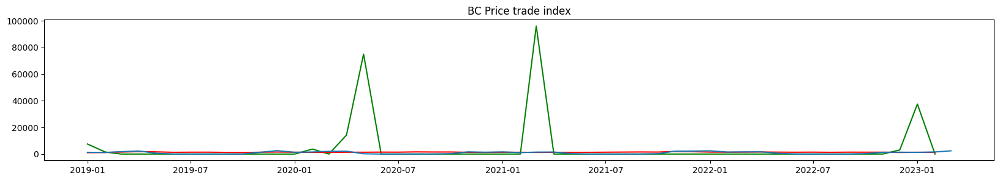

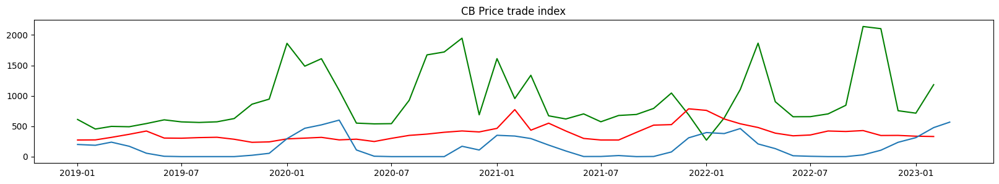

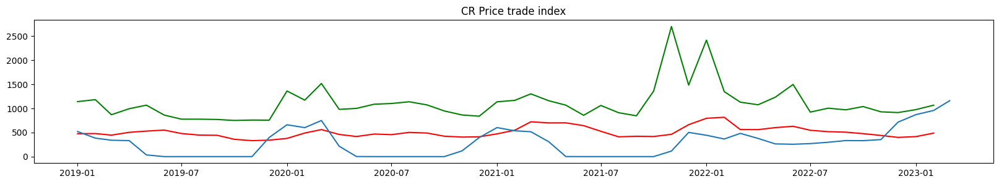

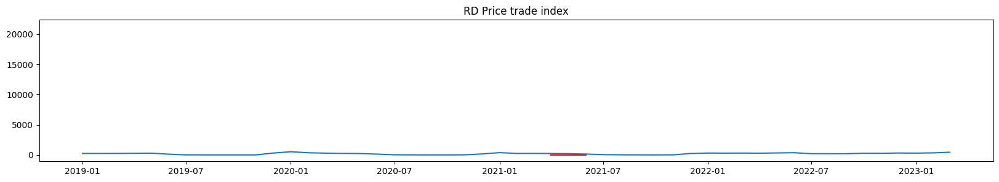

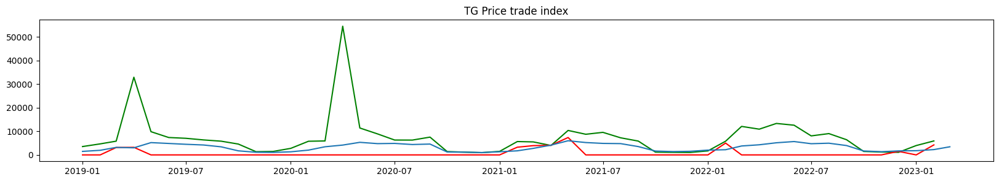

In [25]:
trade_df

trade_df['timestamp'] = pd.to_datetime(trade_df[['year', 'month']].assign(day=1))

for item in trade_df.item.unique():
    plt.figure(figsize=(20,3))
    plt.title(f'{item} Price trade index')
    filtered_df = trade_df[trade_df.item == item]
    plt.plot(filtered_df.timestamp, filtered_df.exp_price, color = 'g')
    plt.plot(filtered_df.timestamp, filtered_df.imp_price,color='r')
    plt.plot(filtered_df.timestamp, filtered_df.price)
    
    # 수출가가 가장 높음 

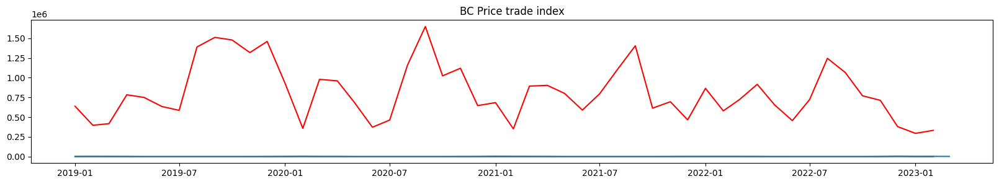

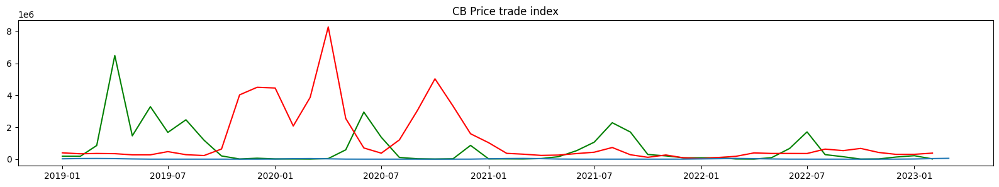

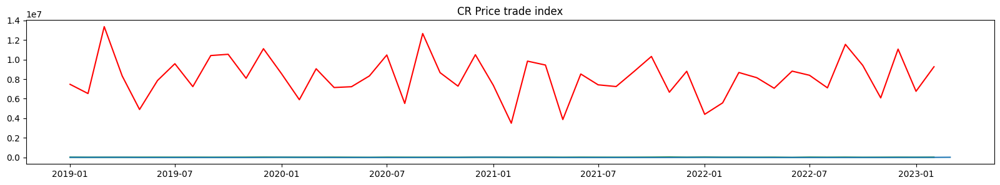

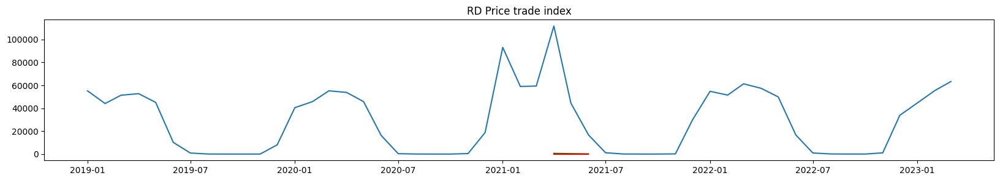

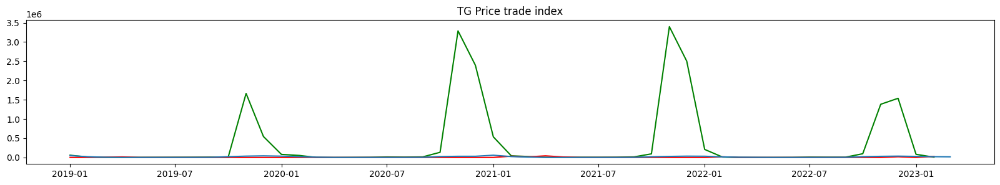

In [26]:
trade_df

for item in trade_df.item.unique():
    plt.figure(figsize=(20,3))
    plt.title(f'{item} Price trade index')
    filtered_df = trade_df[trade_df.item == item]
    plt.plot(filtered_df.timestamp, filtered_df.exp_supply, color = 'g')
    plt.plot(filtered_df.timestamp, filtered_df.imp_supply,color='r')
    plt.plot(filtered_df.timestamp, filtered_df.supply)

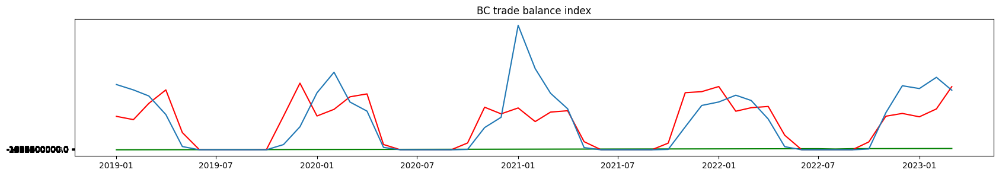

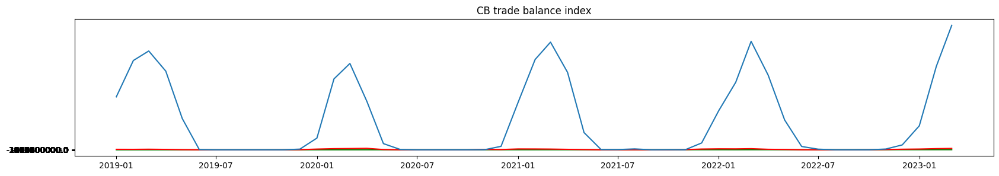

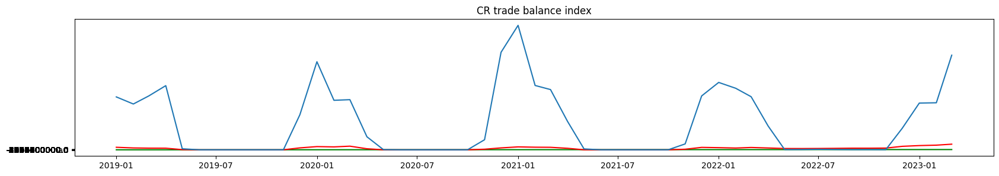

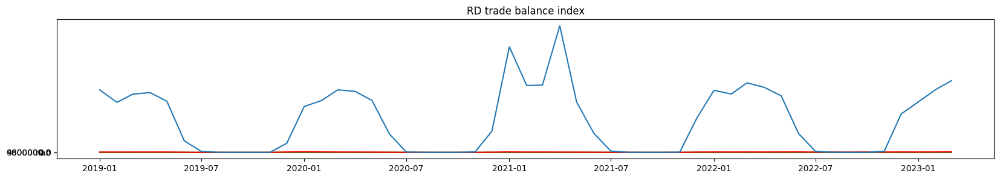

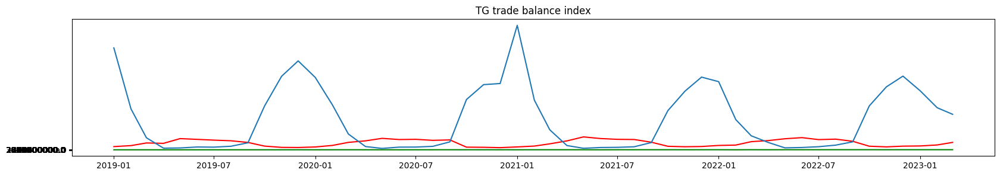

In [27]:
# trade balance, price, supply 

for item in trade_df.item.unique():
    plt.figure(figsize=(20,3))
    plt.title(f'{item} trade balance index')
    filtered_df = trade_df[trade_df.item == item]
    plt.plot(filtered_df.timestamp, filtered_df.trade_balance, color = 'g')
    plt.plot(filtered_df.timestamp, filtered_df.price,color='r')
    plt.plot(filtered_df.timestamp, filtered_df.supply)
    
    # BC의 경우에 trade balance 중요함 

In [29]:
trade_df.iloc[:,3:-1]

,price,supply,exp_price,exp_revenue,exp_supply,imp_price,imp_revenue,imp_supply,trade_balance
0,1278.086022,2494.161290,7500.0,1200000.0,160.0,1057.4,675600000.0,638913.0,-674400000.0
1,1152.563492,2288.412698,1538.5,1200000.0,780.0,1206.4,478800000.0,396870.0,-477600000.0
2,1772.620072,2056.946237,0.0,0.0,100.0,1444.9,603600000.0,417756.0,-603600000.0
3,2288.400000,1347.229630,0.0,0.0,18.0,1848.4,1448400000.0,783593.0,-1448400000.0
4,658.265233,124.301075,0.0,0.0,16.0,1645.4,1233600000.0,749745.0,-1233600000.0
...,...,...,...,...,...,...,...,...,...
250,1361.850000,29303.189000,1220.6,1687200000.0,1382242.0,0.0,0.0,0.0,1687200000.0
251,1696.103226,34294.561290,1089.5,1675200000.0,1537517.0,1500.0,26400000.0,17600.0,1648800000.0
252,1782.693548,27517.410968,3960.3,322800000.0,81509.0,0.0,0.0,0.0,322800000.0
253,2250.250000,19588.908571,5917.3,40800000.0,6895.0,4235.5,117600000.0,27765.0,-76800000.0


In [30]:
scaler = MinMaxScaler()
scaled = scaler.fit_transform(trade_df.iloc[:,3:-1])
scaled = pd.DataFrame(scaled)

In [31]:
pd.DataFrame(trade_df.iloc[:,-1])

,timestamp
0,2019-01-01
1,2019-02-01
2,2019-03-01
3,2019-04-01
4,2019-05-01
...,...
250,2022-11-01
251,2022-12-01
252,2023-01-01
253,2023-02-01


In [32]:
scaled_trade_df = pd.concat([trade_df.iloc[:,:3],scaled],axis=1)
scaled_trade_df = pd.concat([scaled_trade_df, pd.DataFrame(trade_df.iloc[:,-1])],axis=1)
scaled_trade_df.columns = trade_df.columns
scaled_trade_df

,item,year,month,price,supply,exp_price,exp_revenue,exp_supply,imp_price,imp_revenue,imp_supply,trade_balance,timestamp
0,BC,2019,1,0.212993,0.022325,0.078125,0.000313,0.000025,0.143505,0.095198,0.047845,0.586560,2019-01-01
1,BC,2019,2,0.192075,0.020483,0.016026,0.000313,0.000120,0.163726,0.067467,0.029720,0.604597,2019-02-01
2,BC,2019,3,0.295408,0.018412,0.000000,0.000000,0.000015,0.196094,0.085052,0.031284,0.593049,2019-03-01
3,BC,2019,4,0.381363,0.012059,0.000000,0.000000,0.000003,0.250855,0.204092,0.058680,0.515618,2019-04-01
4,BC,2019,5,0.109700,0.001113,0.000000,0.000000,0.000002,0.223305,0.173825,0.056145,0.535306,2019-05-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...
250,TG,2022,11,0.226953,0.262292,0.012715,0.439787,0.212829,0.000000,0.000000,0.000000,0.803014,2022-11-01
251,TG,2022,12,0.282656,0.306969,0.011349,0.436659,0.236737,0.203572,0.003720,0.001318,0.799494,2022-12-01
252,TG,2023,1,0.297087,0.246307,0.041253,0.084141,0.012550,0.000000,0.000000,0.000000,0.677959,2023-01-01
253,TG,2023,2,0.375005,0.175340,0.061639,0.010635,0.001062,0.574819,0.016571,0.002079,0.641333,2023-02-01


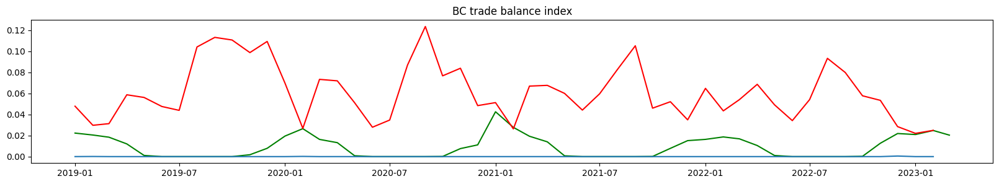

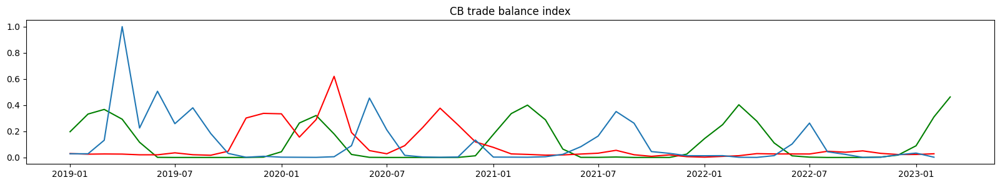

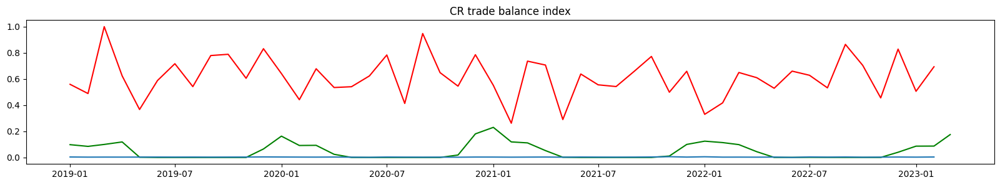

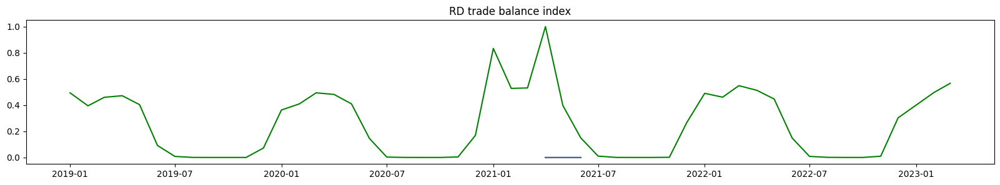

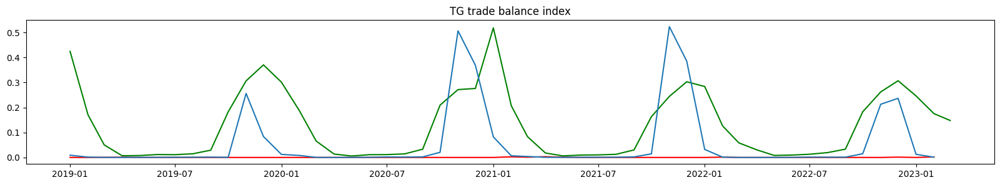

In [33]:
# trade balance, price, supply 

for item in trade_df.item.unique():
    plt.figure(figsize=(20,3))
    plt.title(f'{item} trade balance index')
    filtered_df = scaled_trade_df[scaled_trade_df.item == item]
    plt.plot(filtered_df.timestamp, filtered_df.supply, color = 'g')
    plt.plot(filtered_df.timestamp, filtered_df.imp_supply,color='r')
    plt.plot(filtered_df.timestamp, filtered_df.exp_supply)

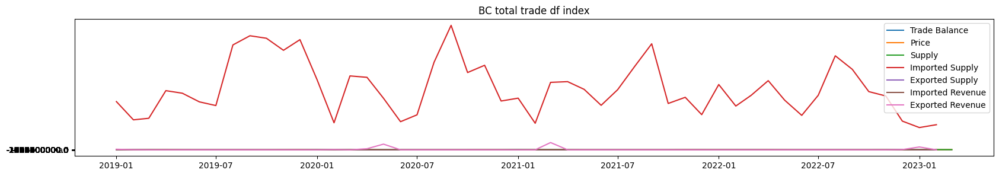

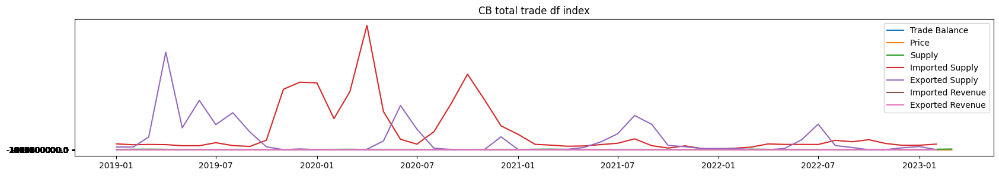

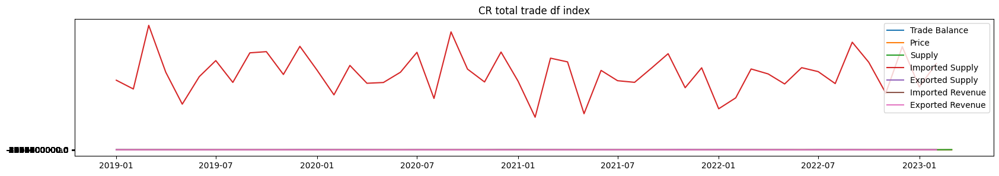

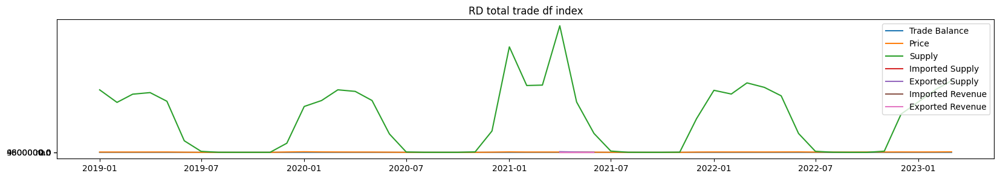

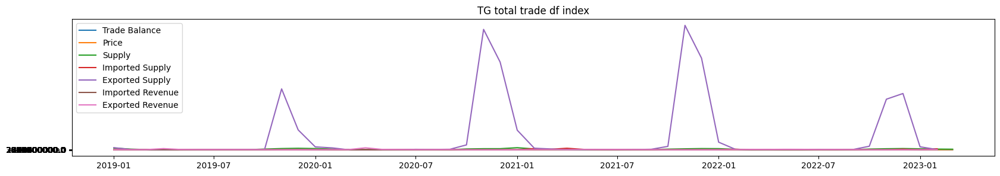

In [34]:
## scaling 전
for item in trade_df.item.unique():
    plt.figure(figsize=(20,3))
    plt.title(f'{item} total trade df index')
    filtered_df = trade_df[trade_df.item == item]
    plt.plot(filtered_df.timestamp, filtered_df.trade_balance, label='Trade Balance')
    plt.plot(filtered_df.timestamp, filtered_df.price, label='Price')
    plt.plot(filtered_df.timestamp, filtered_df.supply, label='Supply')
    plt.plot(filtered_df.timestamp, filtered_df.imp_supply, label='Imported Supply')
    plt.plot(filtered_df.timestamp, filtered_df.exp_supply, label='Exported Supply')
    plt.plot(filtered_df.timestamp, filtered_df.imp_price, label='Imported Revenue')
    plt.plot(filtered_df.timestamp, filtered_df.exp_price, label='Exported Revenue')
    
    # 레이블 표시
    plt.legend()

    # 그래프를 저장하거나 출력하거나 등의 작업 수행
    plt.show()
    
    # BC의 경우에 trade balance 중요함 

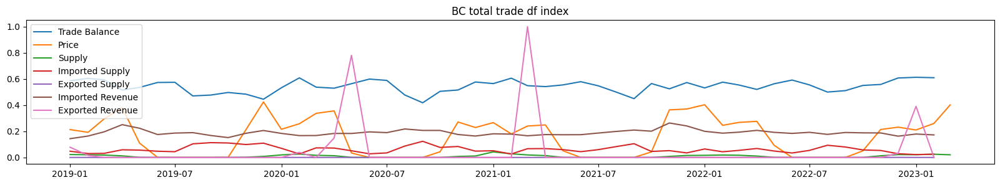

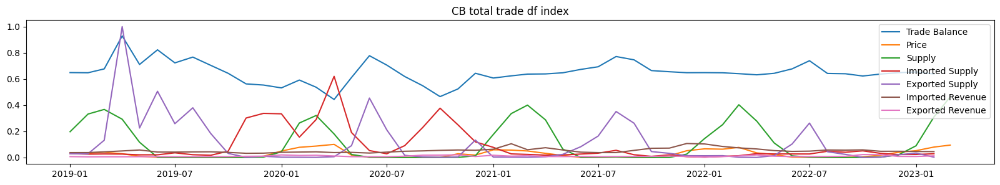

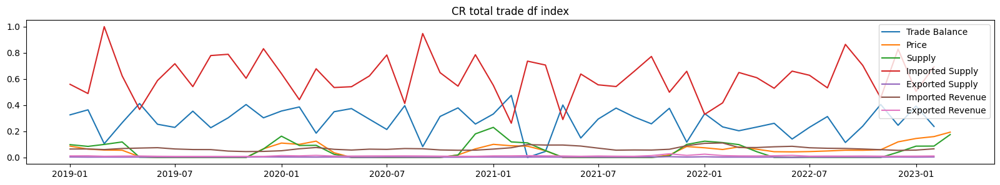

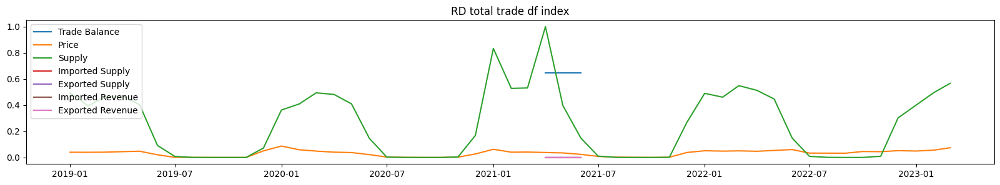

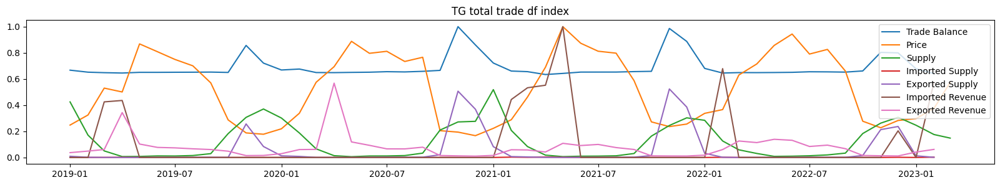

In [35]:
# scaled 된 결과

for item in trade_df.item.unique():
    plt.figure(figsize=(20,3))
    plt.title(f'{item} total trade df index')
    filtered_df = scaled_trade_df[scaled_trade_df.item == item]
    plt.plot(filtered_df.timestamp, filtered_df.trade_balance, label='Trade Balance')
    plt.plot(filtered_df.timestamp, filtered_df.price, label='Price')
    plt.plot(filtered_df.timestamp, filtered_df.supply, label='Supply')
    plt.plot(filtered_df.timestamp, filtered_df.imp_supply, label='Imported Supply')
    plt.plot(filtered_df.timestamp, filtered_df.exp_supply, label='Exported Supply')
    plt.plot(filtered_df.timestamp, filtered_df.imp_price, label='Imported Revenue')
    plt.plot(filtered_df.timestamp, filtered_df.exp_price, label='Exported Revenue')
    
    # 레이블 표시
    plt.legend()

    # 그래프를 저장하거나 출력하거나 등의 작업 수행
    plt.show()
    
    # BC의 경우에 trade balance 중요함 

In [36]:
# 방울다다기 양배추 포함 버전 

In [37]:
# # target [3월 4일 ~ 3월 31일] 

# for name in train['name'].unique():
#     # 월과 일이 각각 3월 4일에서 3월 31일인 경우 필터링
#     filtered_data = train[train['name'] == name]
#     filtered_data = filtered_data[filtered_data['timestamp'].apply(lambda x: '03-04' <= x.strftime('%m-%d') <= '03-31')]
    
#     # 그래프 그리기
#     plt.figure(figsize=(20, 3))
#     plt.plot(filtered_data['timestamp'].apply(lambda x: x.strftime('%m-%d')), filtered_data['price'],label=name)


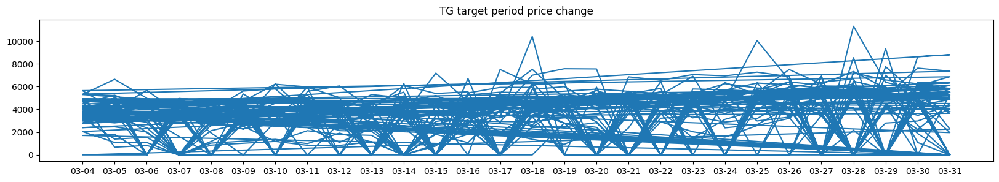

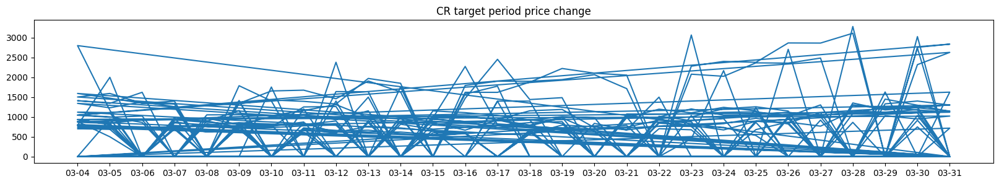

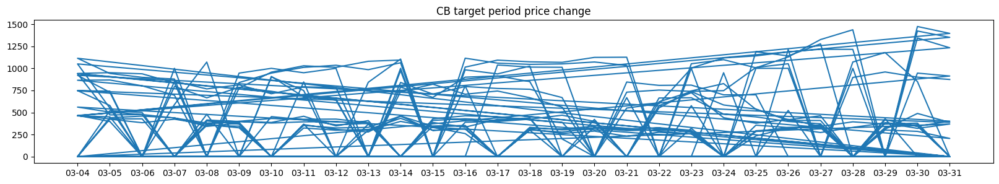

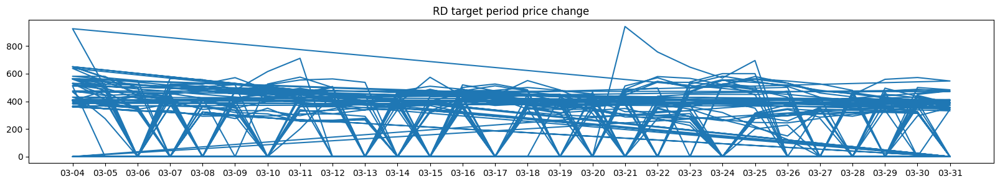

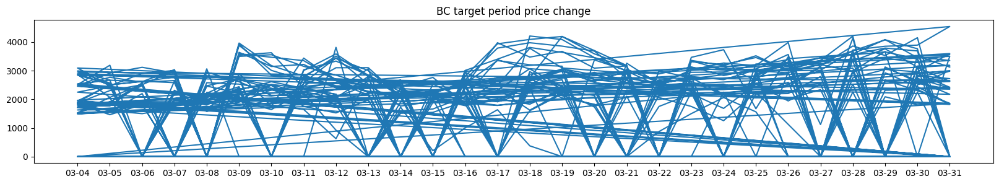

In [38]:

# 각 item에 대해 서로 다른 그래프에 표시하고, 고유한 색상 부여하여 그래프 그리기
for item in train['item'].unique():
    # 월과 일이 각각 3월 4일에서 3월 31일인 경우 필터링
    filtered_data = train[train['item'] == item]
    filtered_data = filtered_data[filtered_data['timestamp'].apply(lambda x: '03-04' <= x.strftime('%m-%d') <= '03-31')]
    
    # 그래프 그리기 및 각 name에 대해 서로 다른 색상 지정
    plt.figure(figsize=(20, 3))
    plt.title(f'{item} target period price change')

    plt.plot(filtered_data['timestamp'].apply(lambda x: x.strftime('%m-%d')), filtered_data['price'])

/tmp/ipykernel_32/2825830237.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(20, 3))


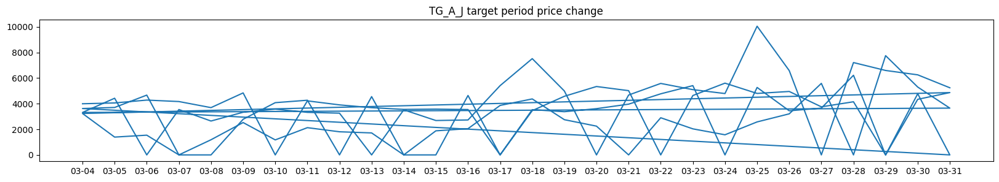

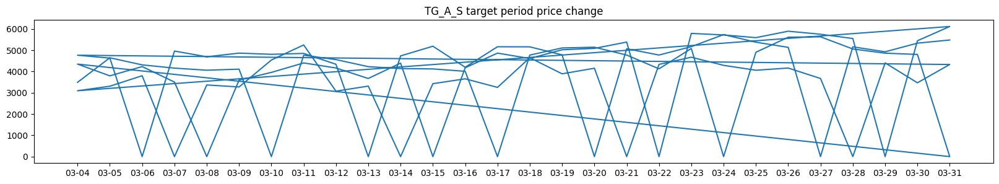

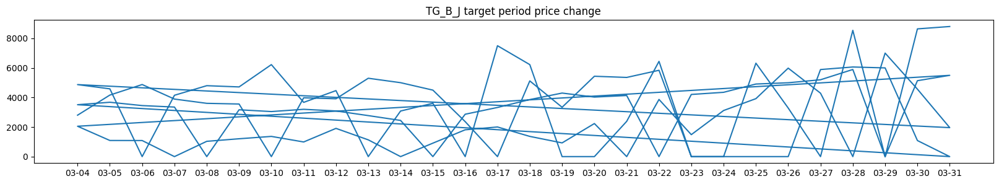

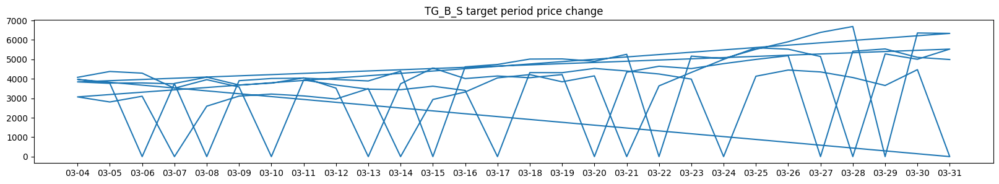

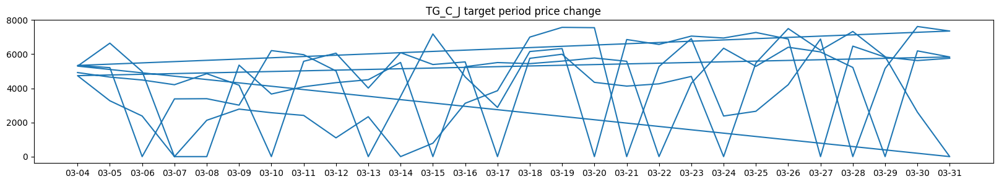

...

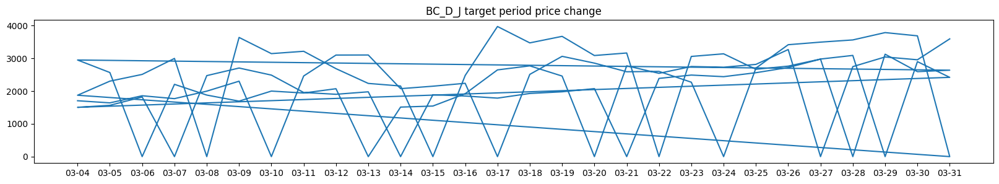

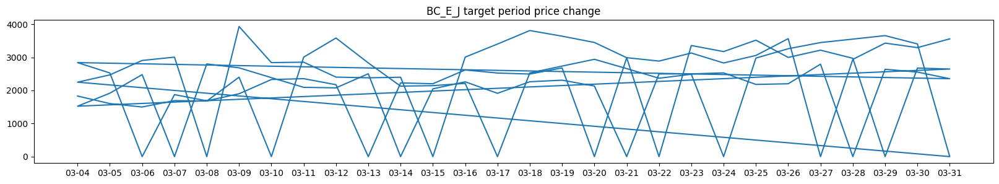

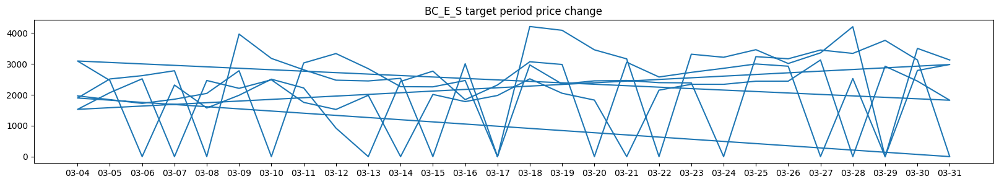

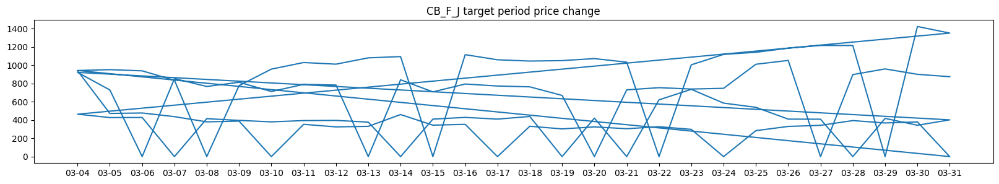

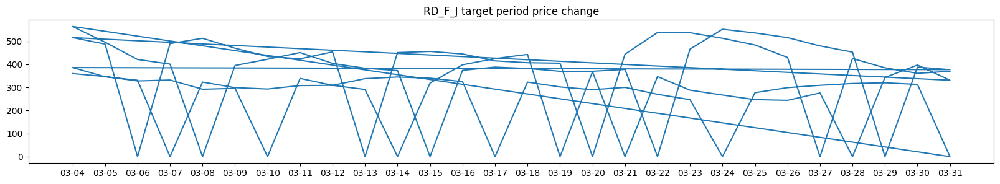

In [39]:

# 각 item에 대해 서로 다른 그래프에 표시하고, 고유한 색상 부여하여 그래프 그리기
for name in train['name'].unique():
    # 월과 일이 각각 3월 4일에서 3월 31일인 경우 필터링
    filtered_data = train[train['name'] == name]
    filtered_data = filtered_data[filtered_data['timestamp'].apply(lambda x: '03-04' <= x.strftime('%m-%d') <= '03-31')]
    
    # 그래프 그리기 및 각 name에 대해 서로 다른 색상 지정
    plt.figure(figsize=(20, 3))
    plt.title(f'{name} target period price change')

    plt.plot(filtered_data['timestamp'].apply(lambda x: x.strftime('%m-%d')), filtered_data['price'])

In [40]:
train['price'].value_counts()



price
0.0       35455
500.0        50
1000.0       45
550.0        42
400.0        41
          ...  
6234.0        1
5686.0        1
5818.0        1
5652.0        1
655.0         1
Name: count, Length: 7094, dtype: int64

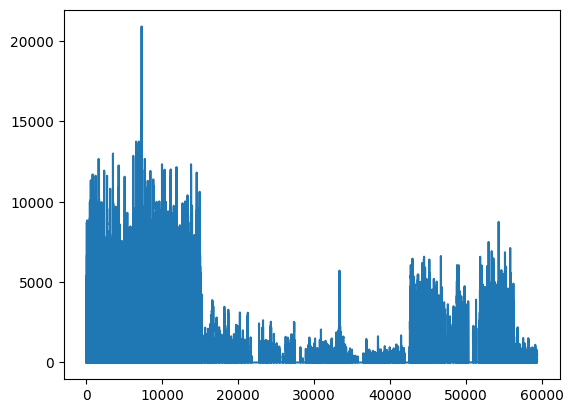

In [44]:
import matplotlib.pyplot as plt


plt.plot(train['price'].index, train['price'].values)

/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


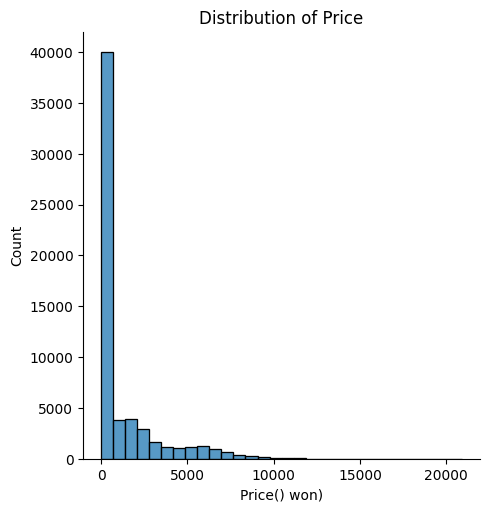

/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


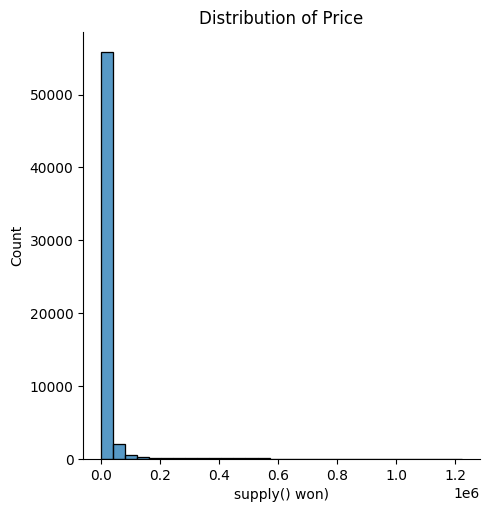

In [55]:
import seaborn as sns 

sns.displot(train['price'], bins=30)
plt.xlabel('Price() won)')
plt.title('Distribution of Price')
plt.show()

sns.displot(train['supply'], bins=30)
plt.xlabel('supply() won)')
plt.title('Distribution of Price')
plt.show()

/opt/conda/lib/python3.10/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


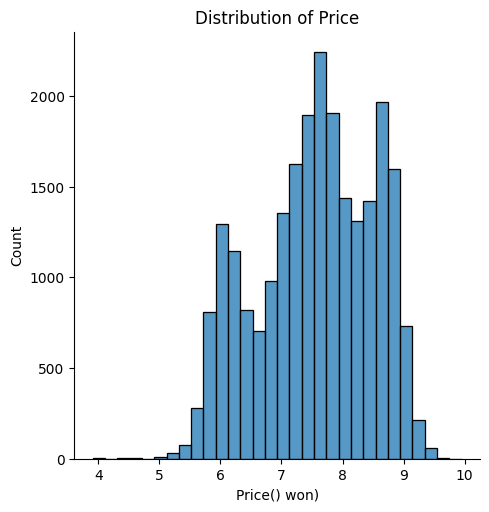

/opt/conda/lib/python3.10/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


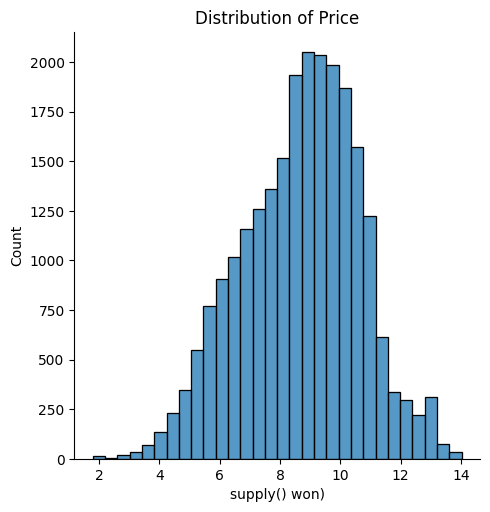

In [56]:
sns.displot(np.log(train['price']), bins=30)
plt.xlabel('Price() won)')
plt.title('Distribution of Price')
plt.show()

sns.displot(np.log(train['supply']), bins=30)
plt.xlabel('supply() won)')
plt.title('Distribution of Price')
plt.show()

/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/opt/conda/lib/python3.10/si

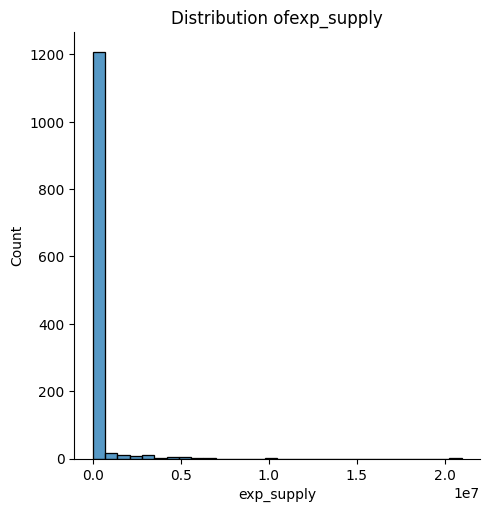

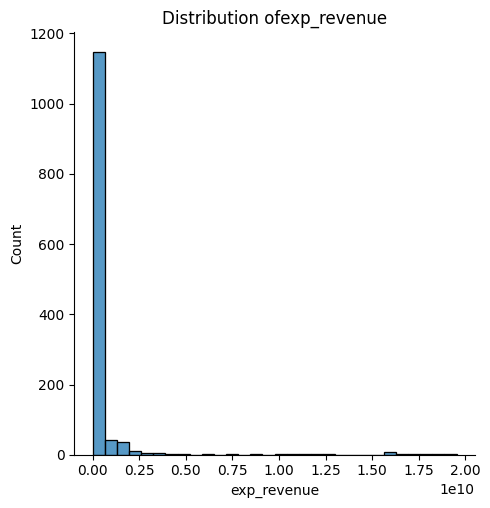

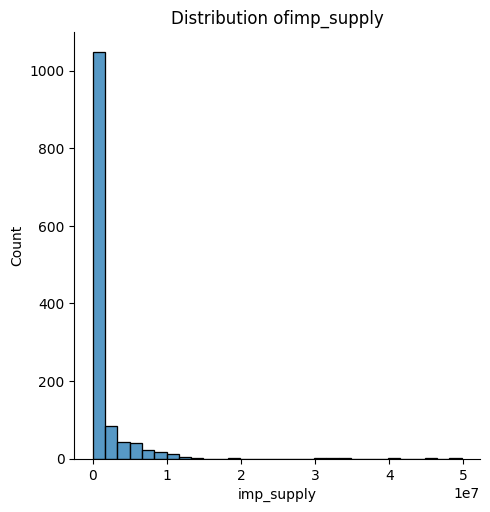

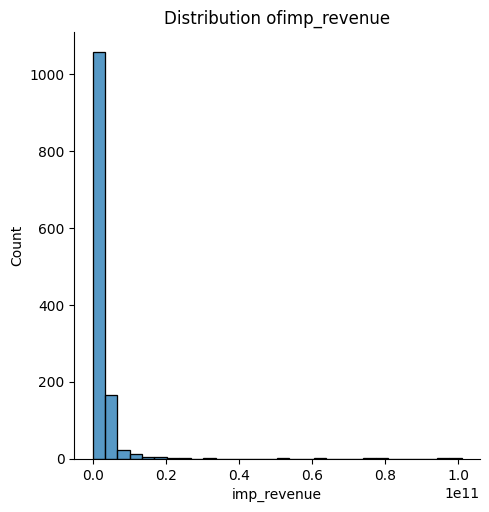

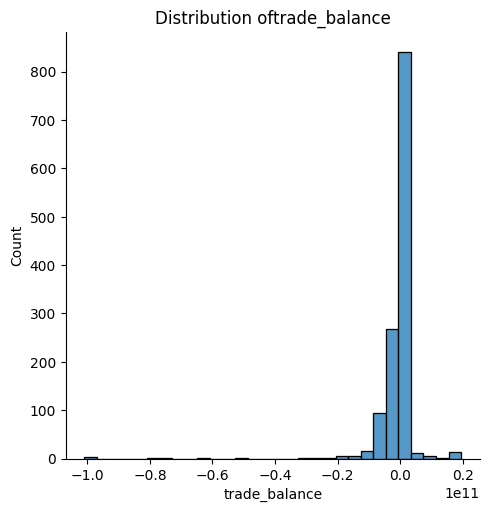

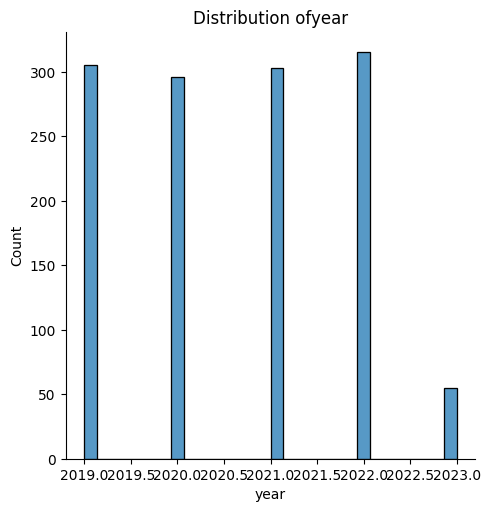

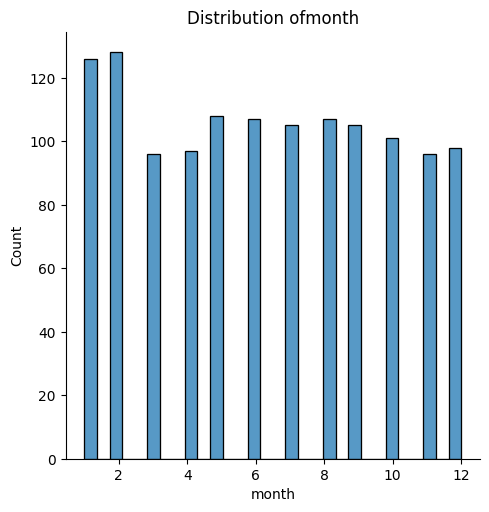

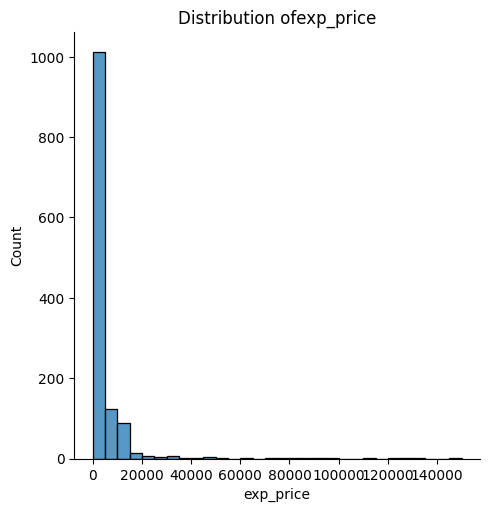

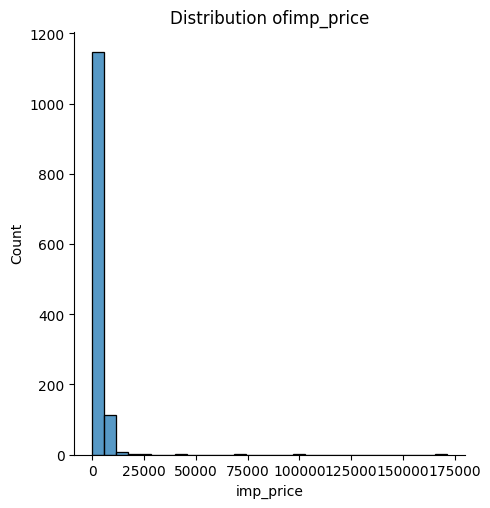

In [60]:
for col in trade.iloc[:,2:].columns:
    sns.displot(trade[col], bins=30)
    plt.xlabel(f'{col}')
    plt.title(f'Distribution of{col}')

/opt/conda/lib/python3.10/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/opt/conda/lib/python3.10/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/opt/conda/lib/python3.10/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwa

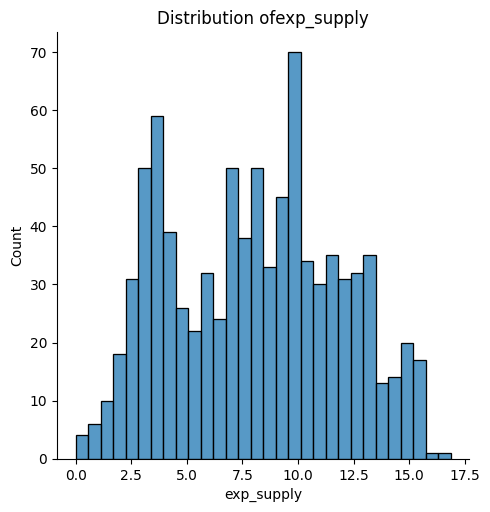

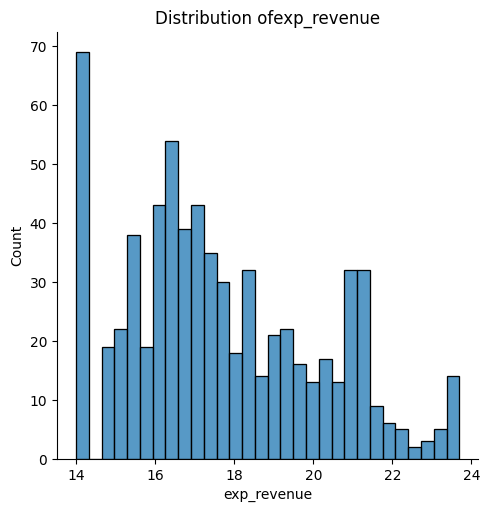

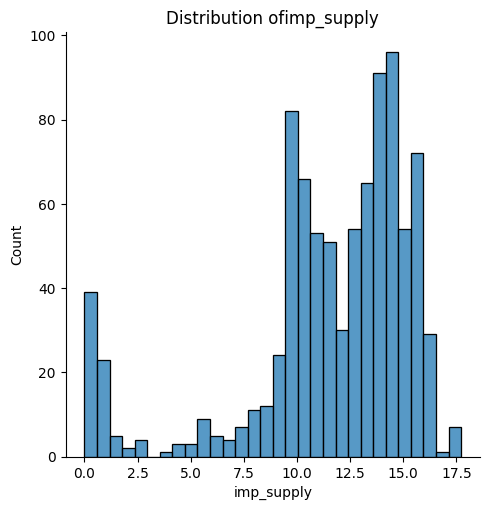

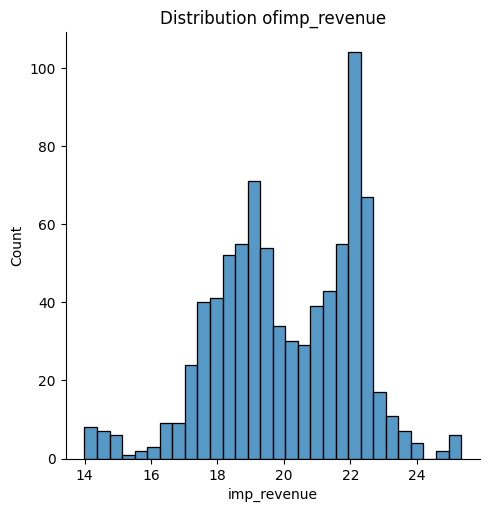

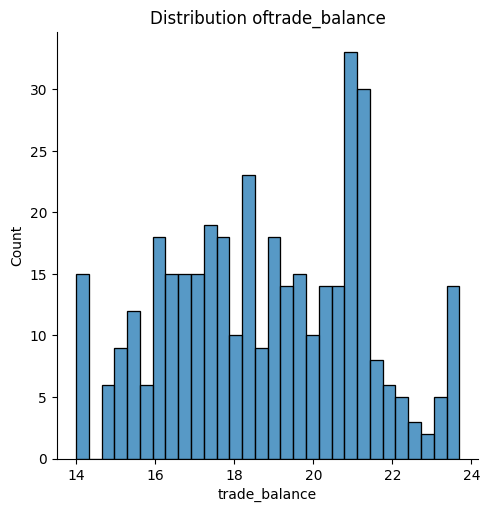

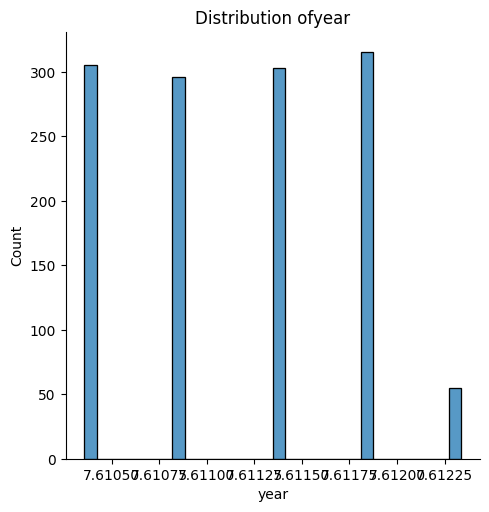

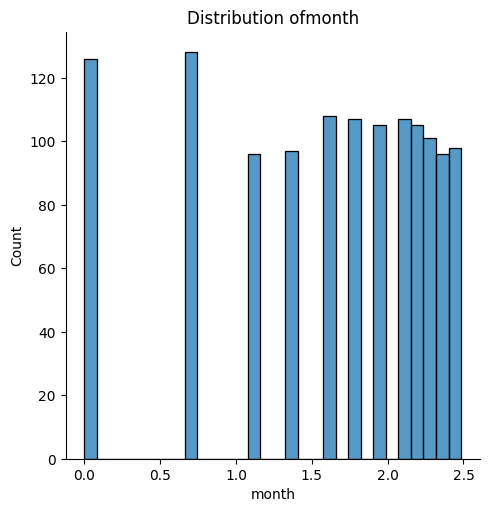

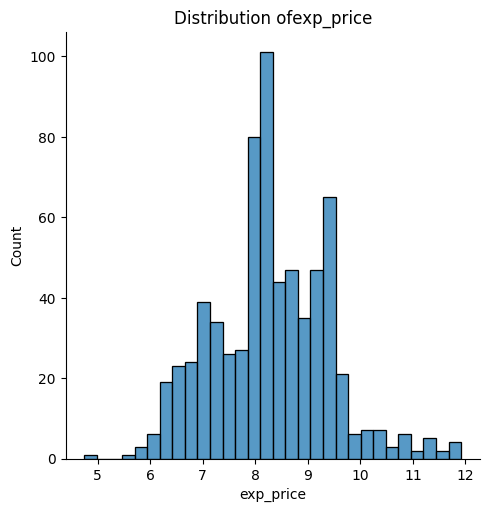

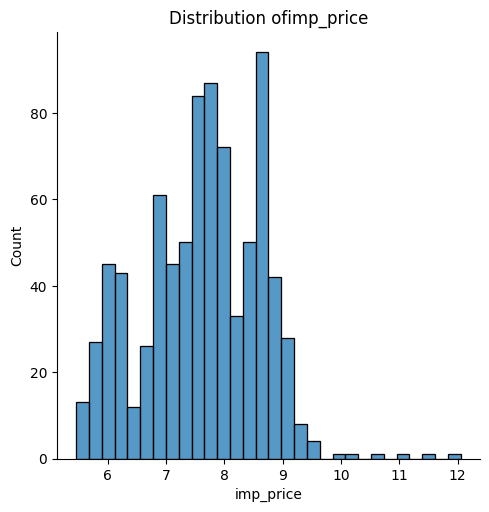

In [61]:
for col in trade.iloc[:,2:].columns:
    sns.displot(np.log(trade[col]), bins=30)
    plt.xlabel(f'{col}')
    plt.title(f'Distribution of{col}')